In [1]:
from shapely.geometry import Point
from unidecode import unidecode
from dotenv import load_dotenv
import pandas as pd
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import warnings
import os

In [2]:
%matplotlib inline

sns.set_style('darkgrid')
warnings.filterwarnings('ignore')
load_dotenv()

True

# Importar Datos

In [3]:
apartments = pd.read_csv('../data/interim/apartments.csv')
apartments.shape

(26081, 25)

In [4]:
apartments['coords_modified'] = False # Para saber si se modificó la coordenada original

In [5]:
apartments.head(3)

,codigo,tipo_propiedad,tipo_operacion,precio_venta,precio_arriendo,area,habitaciones,banos,administracion,parqueaderos,...,descripcion,jacuzzi,piso,closets,chimenea,permite_mascotas,gimnasio,ascensor,conjunto_cerrado,coords_modified
0,374-M2718950,APARTAMENTO,VENTA Y ARRIENDO,2.500000e+09,13500000.0,320.0,4.0,5.0,2500000.0,3.0,...,"vendo o arriendo ph duplex montearroyo, 320 mt...",1,8.0,4.0,1,1,1,1,1,False
1,2510-M4156145,APARTAMENTO,VENTA,4.850000e+08,NaN,84.0,3.0,3.0,680000.0,1.0,...,"oportunidad, bonito apartamento, recien refacc...",0,2.0,3.0,0,0,0,1,1,False
2,10312-M2873283,APARTAMENTO,VENTA Y ARRIENDO,1.980000e+09,9000000.0,248.0,3.0,3.0,2200000.0,3.0,...,presentamos espectacular apartamento en uno de...,0,3.0,NaN,1,1,0,1,1,False


In [6]:
localidades = gpd.read_file('../data/external/localidades_bogota/loca.shp')
localidades.head(3)

,LocNombre,LocAAdmini,LocArea,LocCodigo,SHAPE_Leng,SHAPE_Area,geometry
0,ANTONIO NARIÑO,Acuerdo 117 de 2003,4.879543e+06,15,0.108973,0.000397,"POLYGON ((-74.13075 4.59335, -74.12917 4.59327..."
1,TUNJUELITO,Acuerdo 117 de 2003,9.910940e+06,06,0.210542,0.000807,"POLYGON ((-74.13777 4.59489, -74.13165 4.59363..."
2,RAFAEL URIBE URIBE,Acuerdo 117 de 2003,1.383408e+07,18,0.174513,0.001126,"POLYGON ((-74.12803 4.59254, -74.12777 4.59233..."


In [7]:
barrios = gpd.read_file('../data/external/barrios_bogota/barrios.geojson')
barrios.head(3)

,objectid,cod_loc,localidad,estado,barriocomu,cod_polbar,shape_area,shape_len,geo_shape,geo_point_2d,geometry
0,624,9,Fontibón,SIN LEGALIZAR,Urb. Montevideo Mz 13B,90163,2.670969e-06,0.006991,NaN,"{'lon': -74.1232389247289, 'lat': 4.6429720912...","POLYGON ((-74.12214 4.64306, -74.12345 4.64148..."
1,626,10,Engativá,LEGALIZADO,San Juan,100190,5.450524e-07,0.003002,NaN,"{'lon': -74.11704770473668, 'lat': 4.680566490...","POLYGON ((-74.11653 4.68041, -74.11668 4.68031..."
2,648,1,Usaquén,SIN LEGALIZAR,Torres del Country,10243,4.217785e-07,0.002818,NaN,"{'lon': -74.0470897158071, 'lat': 4.7141192371...","POLYGON ((-74.04760 4.71400, -74.04754 4.71443..."


# Data Corection

## Agregando localidades, segun las coordenadas de los apartamentos

In [8]:
def get_localidad(row):
    try:
        point = Point(row['longitud'], row['latitud'])
        for i, localidad in localidades.iterrows():
            if point.within(localidad['geometry']):
                return unidecode(localidad['LocNombre']).upper()
        return np.nan
    except:
        return np.nan
    
apartments['localidad'] = apartments.apply(get_localidad, axis=1)

In [9]:
apartments.localidad.unique()

array(['USAQUEN', 'SUBA', 'CHAPINERO', nan, 'TEUSAQUILLO',
       'BARRIOS UNIDOS', 'KENNEDY', 'FONTIBON', 'CANDELARIA',
       'ANTONIO NARINO', 'RAFAEL URIBE URIBE', 'SANTA FE', 'BOSA',
       'ENGATIVA', 'USME', 'PUENTE ARANDA', 'LOS MARTIRES',
       'CIUDAD BOLIVAR', 'SAN CRISTOBAL', 'TUNJUELITO', 'SUMAPAZ'],
      dtype=object)

eliminados todos los registros que no tienen localidad y sector asignado

In [10]:
apartments = apartments.dropna(subset=['localidad', 'sector'], how='all')

In [11]:
fig = px.scatter_mapbox(
    apartments.loc[apartments['localidad'].notnull()],
    lat='latitud', 
    lon='longitud', 
    color='estrato', 
    zoom=10, 
    height=500,
    hover_name='localidad',
    hover_data=['area', 'habitaciones', 'banos', 'estrato', 'codigo', 'sector', 'precio_venta', 'precio_arriendo'],
    color_continuous_scale=px.colors.sequential.Viridis,
)

fig.update_layout(
    mapbox=dict(
        accesstoken=os.getenv('MAPBOX_TOKEN'),
        style='dark',
        center=dict(
            lat=4.60971,
            lon=-74.08175
        )
    )
)

fig.update_layout(margin={'r': 0, 't': 0, 'l': 0, 'b': 0})
fig.show()

hay ubicacion que no concuerda con la localidad, ni el sector

## Agregando barrios, segun las coordenadas de los apartamentos

In [12]:
def normalize_text(text):
    try:
        return unidecode(text).upper()
    except:
        return text

In [13]:
barrios.head(3)

,objectid,cod_loc,localidad,estado,barriocomu,cod_polbar,shape_area,shape_len,geo_shape,geo_point_2d,geometry
0,624,9,Fontibón,SIN LEGALIZAR,Urb. Montevideo Mz 13B,90163,2.670969e-06,0.006991,NaN,"{'lon': -74.1232389247289, 'lat': 4.6429720912...","POLYGON ((-74.12214 4.64306, -74.12345 4.64148..."
1,626,10,Engativá,LEGALIZADO,San Juan,100190,5.450524e-07,0.003002,NaN,"{'lon': -74.11704770473668, 'lat': 4.680566490...","POLYGON ((-74.11653 4.68041, -74.11668 4.68031..."
2,648,1,Usaquén,SIN LEGALIZAR,Torres del Country,10243,4.217785e-07,0.002818,NaN,"{'lon': -74.0470897158071, 'lat': 4.7141192371...","POLYGON ((-74.04760 4.71400, -74.04754 4.71443..."


In [14]:
barrios['barriocomu'] = barrios['barriocomu'].apply(normalize_text)
barrios['localidad'] = barrios['localidad'].apply(normalize_text)
barrios.localidad.unique()

array(['FONTIBON', 'ENGATIVA', 'USAQUEN', 'RAFAEL URIBE', 'TEUSAQUILLO',
       'TUNJUELITO', 'USME', 'SAN CRISTOBAL', 'SANTA FE', nan,
       'BARRIOS UNIDOS', 'PUENTE ARANDA', 'CANDELARIA', 'KENNEDY', 'BOSA',
       'CIUDAD BOLIVAR', 'LOS MARTIRES', 'CHAPINERO', 'ANTONIO NARINO'],
      dtype=object)

In [15]:
barrios.loc[barrios['localidad'] == 'RAFAEL URIBE', 'localidad'] = 'RAFAEL URIBE URIBE'

<Axes: >

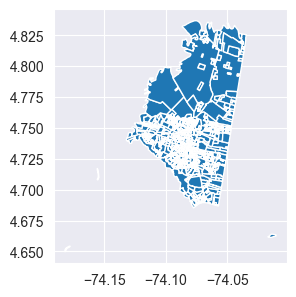

In [16]:
barrios[barrios['localidad'].isna()].plot(figsize=(3, 5))

In [17]:
barrios.loc[barrios['localidad'].isna(), 'localidad'] = 'SUBA'

In [18]:
def get_barrio(row):
    try:
        point = Point(row['longitud'], row['latitud'])
        loca = row['localidad']
        barrios_localidad = barrios.loc[barrios['localidad'] == loca]
        for i, barrio in barrios_localidad.iterrows():
            if point.within(barrio['geometry']):
                return barrio['barriocomu']
            
        return np.nan
    except:
        return np.nan
    
apartments['barrio'] = apartments.apply(get_barrio, axis=1)

In [19]:
fig = px.scatter_mapbox(
    apartments.loc[apartments['localidad'].notnull()],
    lat='latitud', 
    lon='longitud', 
    color='estrato', 
    zoom=10, 
    height=500,
    hover_name='barrio',
    hover_data=['area', 'habitaciones', 'banos', 'estrato', 'codigo', 'sector', 'precio_venta', 'precio_arriendo', 'localidad'],
    color_continuous_scale=px.colors.sequential.Viridis,
)

fig.update_layout(
    mapbox=dict(
        accesstoken=os.getenv('MAPBOX_TOKEN'),
        style='dark',
        center=dict(
            lat=4.60971,
            lon=-74.08175
        )
    )
)

fig.update_layout(margin={'r': 0, 't': 0, 'l': 0, 'b': 0})
fig.show()

## Corrigiendo las coordenadas de los apartamentos

In [20]:
apartments.drop(apartments.loc[apartments['codigo'] == 'RV-M4025919'].index, inplace=True)
apartments.drop(apartments.loc[apartments['codigo'] == '5044-M3190864'].index, inplace=True)
apartments.drop(apartments.loc[apartments['codigo'] == '10139-M4067176'].index, inplace=True)
apartments.drop(apartments.loc[apartments['codigo'] == '342-M4308868'].index, inplace=True)
apartments.drop(apartments.loc[apartments['codigo'] == '342-M3682473'].index, inplace=True)
apartments.loc[apartments['codigo'] == '13036-M4208709', 'sector'] = 'LOS ROSALES'
apartments.loc[(apartments['sector'] == 'OTROS') & (apartments['localidad'] == 'USME'), 'sector'] = 'LOS ROSALES'
apartments.loc[(apartments['sector'].isna()) & (apartments['localidad'] == 'USME') & (apartments['estrato'] == 6) & (apartments['tipo_operacion'] == 'VENTA'), 'sector'] = 'LOS ROSALES'
apartments.loc[(apartments['sector'].isna()) & (apartments['localidad'] == 'USME') & (apartments['estrato'] == 6) & (apartments['tipo_operacion'] == 'ARRIENDO'), 'sector'] = 'CHICO'
apartments.loc[(apartments['sector'].isna()) & (apartments['localidad'] == 'RAFAEL URIBE URIBE') & (apartments['estrato'] == 6), 'sector'] = 'LOS ROSALES'
apartments.loc[(apartments['barrio'] == 'EL TRIUNFO') & (apartments['estrato'] == 6), 'sector'] = 'SANTA BARBARA'
apartments.loc[(apartments['localidad'] == 'PUENTE ARANDA') & (apartments['estrato'] == 6), 'sector'] = 'CHICO'

In [21]:
chapi_barr = barrios.loc[barrios['localidad'] == 'SUBA', 'barriocomu'].unique().tolist()

for i in chapi_barr:
    if 'COLINAS DE SUBA' in i:
        print(i)

URB. LAS COLINAS DE SUBA


In [25]:
def rondom_coords_in_polygon(polygon):
    while True:
        x = np.random.uniform(polygon.bounds['minx'], polygon.bounds['maxx'])[0]
        y = np.random.uniform(polygon.bounds['miny'], polygon.bounds['maxy'])[0]
        point = Point(x, y)
        if polygon.contains(point).any():
            return x, y

def correction_ubication(row):
    if row['sector'] == 'CHICO':
        if row['localidad'] == 'CHAPINERO' or row['localidad'] == 'USAQUEN':
            pass
        else:
            # Cambiar las coordenadas a un punto random dentro del poligono
            chico = barrios.loc[barrios['barriocomu'] == 'S.C. CHICO NORTE', 'geometry']

            x, y = rondom_coords_in_polygon(chico)

            row['latitud'] = float(y)
            row['longitud'] = float(x)
            row['coords_modified'] = True
            row['localidad'] = 'CHAPINERO'
            row['barrio'] = 'S.C. CHICO NORTE'

    elif row['sector'] == 'CEDRITOS' and row['localidad'] != 'USAQUEN':
        cedritos = barrios.loc[barrios['barriocomu'] == 'CEDRITOS', 'geometry']

        x, y = rondom_coords_in_polygon(cedritos)

        row['latitud'] = float(y)
        row['longitud'] = float(x)
        row['coords_modified'] = True
        row['localidad'] = 'USAQUEN'
        row['barrio'] = 'CEDRITOS'

    elif row['sector'] == 'CHAPINERO ALTO' and row['localidad'] != 'CHAPINERO':
        chapinero_norte = barrios.loc[barrios['barriocomu'] == 'S.C. CHAPINERO NORTE', 'geometry']

        x, y = rondom_coords_in_polygon(chapinero_norte)

        row['latitud'] = float(y)
        row['longitud'] = float(x)
        row['coords_modified'] = True
        row['localidad'] = 'CHAPINERO'
        row['barrio'] = 'S.C. CHAPINERO NORTE'

    elif row['sector'] == 'LOS ROSALES' and row['localidad'] != 'CHAPINERO':
        rosales = barrios.loc[barrios['barriocomu'] == 'LOS ROSALES', 'geometry']

        x, y = rondom_coords_in_polygon(rosales)

        row['latitud'] = float(y)
        row['longitud'] = float(x)
        row['coords_modified'] = True
        row['localidad'] = 'CHAPINERO'
        row['barrio'] = 'LOS ROSALES'

    elif row['sector'] == 'PUENTE ARANDA' and row['localidad'] != 'PUENTE ARANDA':
        puente_aranda = localidades.loc[localidades['LocNombre'] == 'PUENTE ARANDA', 'geometry']

        x, y = rondom_coords_in_polygon(puente_aranda)

        row['latitud'] = float(y)
        row['longitud'] = float(x)
        row['coords_modified'] = True
        row['localidad'] = 'PUENTE ARANDA'
        row['barrio'] = 'PUENTE ARANDA'

    elif row['sector'] == 'SANTA BARBARA' and row['localidad'] != 'USAQUEN':
        santa_barbara = barrios.loc[barrios['barriocomu'] == 'SANTA BARBARA OCCIDENTAL', 'geometry']

        x, y = rondom_coords_in_polygon(santa_barbara)

        row['latitud'] = float(y)
        row['longitud'] = float(x)
        row['coords_modified'] = True
        row['localidad'] = 'USAQUEN'
        row['barrio'] = 'SANTA BARBARA OCCIDENTAL'

    elif row['sector'] == 'COUNTRY':
        if row['localidad'] == 'CHAPINERO' or row['localidad'] == 'USAQUEN':
            pass
        
        else:
            country = barrios.loc[barrios['barriocomu'] == 'NUEVO COUNTRY', 'geometry']

            x, y = rondom_coords_in_polygon(country)

            row['latitud'] = float(y)
            row['longitud'] = float(x)
            row['coords_modified'] = True
            row['localidad'] = 'CHAPINERO'
            row['barrio'] = 'NUEVO COUNTRY'

    elif row['sector'] == 'CENTRO INTERNACIONAL' and row['localidad'] != 'SANTA FE':
        samper = barrios.loc[barrios['barriocomu'] == 'SAMPER', 'geometry']
        
        x, y = rondom_coords_in_polygon(samper)

        row['latitud'] = float(y)
        row['longitud'] = float(x)
        row['coords_modified'] = True
        row['localidad'] = 'SANTA FE'
        row['barrio'] = 'SAMPER'

    else:
        pass

    return row

apartments = apartments.apply(correction_ubication, axis=1)


In [26]:
fig = px.scatter_mapbox(
    apartments,
    lat='latitud', 
    lon='longitud', 
    color='coords_modified',
    zoom=10, 
    height=500,
    hover_name='barrio',
    hover_data=['area', 'habitaciones', 'banos', 'estrato', 'codigo', 'sector', 'precio_venta', 'precio_arriendo', 'localidad'],
    color_continuous_scale=px.colors.sequential.Viridis,
)

fig.update_layout(
    mapbox=dict(
        accesstoken=os.getenv('MAPBOX_TOKEN'),
        style='dark',
        center=dict(
            lat=4.60971,
            lon=-74.08175
        )
    )
)

fig.update_layout(margin={'r': 0, 't': 0, 'l': 0, 'b': 0})
fig.show()

In [36]:
out = apartments.loc[(apartments['localidad'] == 'KENNEDY') & (apartments['estrato'] == 6)]
apartments = apartments.drop(out.index)

In [38]:
out = apartments.loc[(apartments['localidad'] == 'RAFAEL URIBE URIBE') & (apartments['estrato'] == 6)]
apartments = apartments.drop(out.index)

In [39]:
fig = px.scatter_mapbox(
    apartments,
    lat='latitud', 
    lon='longitud', 
    color='estrato',
    zoom=10, 
    height=500,
    hover_name='barrio',
    hover_data=['area', 'habitaciones', 'banos', 'estrato', 'codigo', 'sector', 'precio_venta', 'precio_arriendo', 'localidad'],
    color_continuous_scale=px.colors.sequential.Viridis,
)

fig.update_layout(
    mapbox=dict(
        accesstoken=os.getenv('MAPBOX_TOKEN'),
        style='dark',
        center=dict(
            lat=4.60971,
            lon=-74.08175
        )
    )
)

fig.update_layout(margin={'r': 0, 't': 0, 'l': 0, 'b': 0})
fig.show()

## Eliminando los apartamentos que estan fueran de Bogota

In [43]:
apartments.dropna(subset=['localidad', 'barrio'], how='all', inplace=True)

In [44]:
apartments.shape

(25370, 28)

In [45]:
apartments.to_csv('../data/interim/apartments.csv', index=False)

In [46]:
import session_info

session_info.show()